In [1]:
from DPOD.datasets.linemod.models_handler import ModelsHandler
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

In [62]:
mh = ModelsHandler(models_dir_path="test")

test/Ape
test/Cat
test/Can
test/Eggbox
test/Duck
test/Glue
test/Driller
{'Ape': 1, 'Can': 2, 'Cat': 3, 'Driller': 4, 'Duck': 5, 'Eggbox': 6, 'Glue': 7}


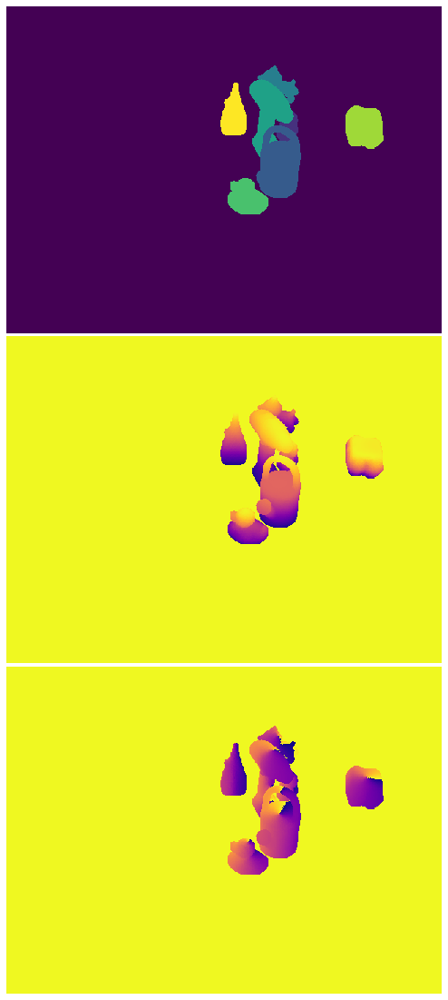

In [61]:
color_u, color_v, class_mask = np.load("/home/mateusz/datasets/linemod/masks_005m/00000_masks.npy")
image_file = Image.open("/home/mateusz/datasets/linemod/RGB-D/rgb_noseg/color_00000.png")
image = np.array(image_file.convert("RGB"))
fig, axs = plt.subplots(3, 1, figsize=(20,20),gridspec_kw=dict(wspace=0.01, hspace=0.01))
axs[1].imshow(color_u, cmap="plasma")
for i in range(3):
    axs[i].axis('off')
axs[2].imshow(color_v, cmap="plasma")
axs[0].imshow(class_mask)
# axs[0].imshow(image)
plt.savefig("elo.png", dpi=100, bbox_inches='tight', pad_inches = 0)

In [20]:
from DPOD.datasets.linemod.models_handler import get_reversed_mapping
color_u, color_v, class_mask = np.load("00000_masks.npy")

pixels_to_consider = np.where(class_mask == 4)

observed_colors = np.stack([
    color_u[pixels_to_consider].flatten(),
    color_v[pixels_to_consider].flatten(),
]).T.astype(int)
# idx = np.array(list(product(range(255), range(255))))

# mapping = get_reversed_mapping(mh, "Driller")



In [21]:
image = np.zeros((480, 640, 2))
image = mh.draw_color_mask(image, 'Driller', np.array([[-0.98518263, -0.00731994, -0.17223703],
       [-0.05457616,  0.96104305,  0.27126559],
       [ 0.16352148,  0.27658797, -0.94709658]]), np.array([0,0, -0.5]))

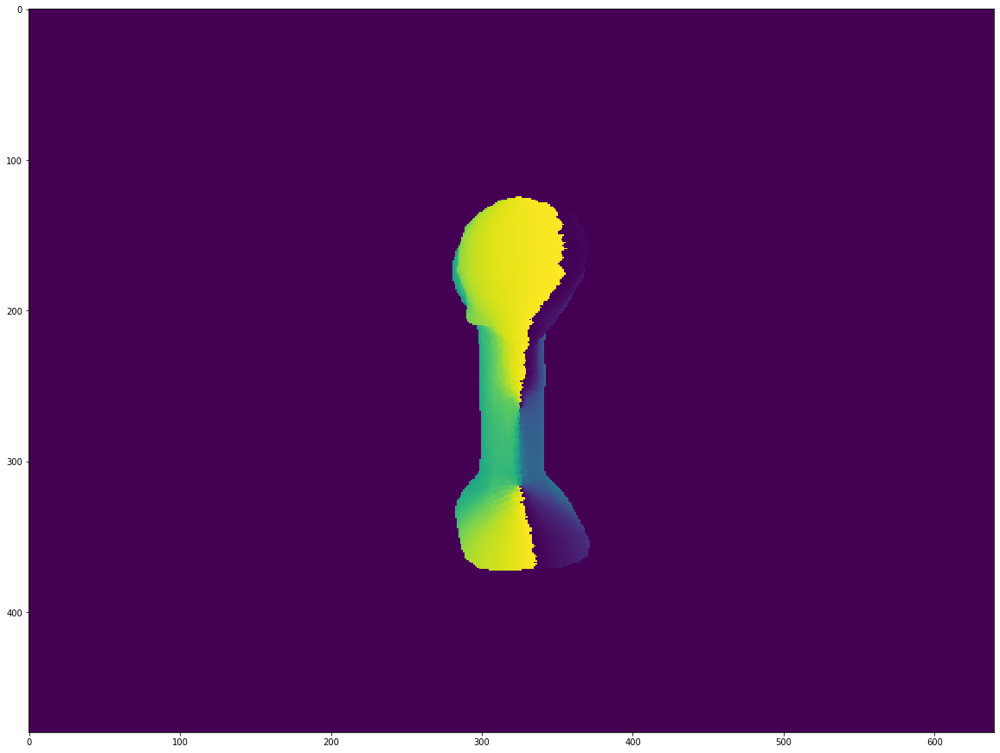

In [22]:
plt.figure(figsize=(20, 20))
plt.imshow(image[:, :, 1])
# plt.colorbar()

In [23]:
d = mh.get_color_to_xz("Can")
d.shape

/home/mateusz/.pyenv/versions/3.7.3/envs/sdk/lib/python3.7/site-packages/scipy/interpolate/interpolate.py:609: RuntimeWarning:

divide by zero encountered in true_divide

/home/mateusz/.pyenv/versions/3.7.3/envs/sdk/lib/python3.7/site-packages/scipy/interpolate/interpolate.py:612: RuntimeWarning:

invalid value encountered in multiply



(255, 2)

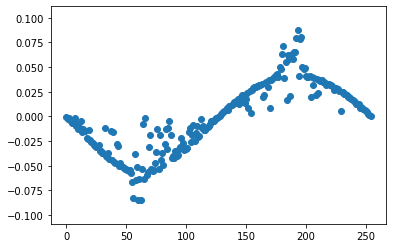

In [24]:
plt.scatter(np.arange(255), d[:,0])

In [25]:
d2 = mh.get_color_to_3dpoints_arrays("Driller")
d2.shape

(255, 255, 3)

In [63]:
import plotly.graph_objects as go
color_u, color_v, class_mask = np.load("/home/mateusz/datasets/linemod/masks_005m/00000_masks.npy")

pixels_to_consider = np.where(class_mask == 5)

observed_colors = np.stack([
    color_u[pixels_to_consider].flatten(),
    color_v[pixels_to_consider].flatten(),
]).T.astype(int)
# idx = np.array(list(product(range(255), range(255))))

points_observed = mh.get_color_to_3dpoints_arrays("Duck")[
        observed_colors[:, 0], observed_colors[:, 1]]
fig = go.Figure(data=[go.Scatter3d(x=points_observed[:, 2], 
                                   y=points_observed[:, 0],
                                   z=points_observed[:, 1], 
                                   mode='markers',
                                   marker=dict(color=observed_colors[:, 0],size=1),    
                                  )])
# fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

In [47]:
mh = ModelsHandler(models_dir_path="models_big")
ver = mh.get_vertices("Duck")

models_big/Ape
models_big/Cat
models_big/Can
models_big/Eggbox
models_big/Duck
models_big/Glue
models_big/Driller
{'Ape': 1, 'Can': 2, 'Cat': 3, 'Driller': 4, 'Duck': 5, 'Eggbox': 6, 'Glue': 7}


In [50]:
# color_arr = (np.arctan2(ver[:, 2], ver[:, 0]) + np.pi) / np.pi / 2
color_arr = (ver[:, 1] - ver[:, 1].min())/(ver[:, 1].max() - ver[:, 1].min())

In [51]:

fig = go.Figure(data=[go.Scatter3d(x=ver[:, 0], 
                                   y=ver[:, 2],
                                   z=ver[:, 1], 
                                   mode='markers',  
                                   marker=dict(color=color_arr,size=1),
                                  )])
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()